In [4]:
import pandas as pd
import numpy as np
from __future__ import division
from datetime import datetime
from collections import Counter
import csv
from collections import defaultdict
from datetime import datetime

In [5]:
!curl -O http://web.mta.info/developers/data/nyct/turnstile/turnstile_150627.txt


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 24.0M    0 24.0M    0     0  6154k      0 --:--:--  0:00:04 --:--:-- 6155k


In [6]:
with open('turnstile_150627.txt') as f:
    reader = csv.reader(f)
    rows = [[cell.strip() for cell in row] for row in reader]

In [7]:
rows.pop(0)

['C/A',
 'UNIT',
 'SCP',
 'STATION',
 'LINENAME',
 'DIVISION',
 'DATE',
 'TIME',
 'DESC',
 'ENTRIES',
 'EXITS']

In [8]:
rows[:10]

[['A002',
  'R051',
  '02-00-00',
  'LEXINGTON AVE',
  'NQR456',
  'BMT',
  '06/20/2015',
  '00:00:00',
  'REGULAR',
  '0005192500',
  '0001756572'],
 ['A002',
  'R051',
  '02-00-00',
  'LEXINGTON AVE',
  'NQR456',
  'BMT',
  '06/20/2015',
  '04:00:00',
  'REGULAR',
  '0005192550',
  '0001756580'],
 ['A002',
  'R051',
  '02-00-00',
  'LEXINGTON AVE',
  'NQR456',
  'BMT',
  '06/20/2015',
  '08:00:00',
  'REGULAR',
  '0005192568',
  '0001756609'],
 ['A002',
  'R051',
  '02-00-00',
  'LEXINGTON AVE',
  'NQR456',
  'BMT',
  '06/20/2015',
  '12:00:00',
  'REGULAR',
  '0005192670',
  '0001756706'],
 ['A002',
  'R051',
  '02-00-00',
  'LEXINGTON AVE',
  'NQR456',
  'BMT',
  '06/20/2015',
  '16:00:00',
  'REGULAR',
  '0005192886',
  '0001756776'],
 ['A002',
  'R051',
  '02-00-00',
  'LEXINGTON AVE',
  'NQR456',
  'BMT',
  '06/20/2015',
  '20:00:00',
  'REGULAR',
  '0005193250',
  '0001756837'],
 ['A002',
  'R051',
  '02-00-00',
  'LEXINGTON AVE',
  'NQR456',
  'BMT',
  '06/21/2015',
  '00:00:0

In [9]:
onerow = f.ix[0]

AttributeError: 'file' object has no attribute 'ix'

In [11]:
d = defaultdict(list)
for row in rows:
    location = tuple(row[:4])
    stats = tuple(row[4:])
    d[location].append(stats)

In [13]:
d

defaultdict(list,
            {('B014',
              'R148',
              '00-00-01',
              'PARKSIDE AVE'): [('BQ',
               'BMT',
               '06/20/2015',
               '01:00:00',
               'REGULAR',
               '0012582818',
               '0007951257'), ('BQ',
               'BMT',
               '06/20/2015',
               '05:00:00',
               'REGULAR',
               '0012582852',
               '0007951262'), ('BQ',
               'BMT',
               '06/20/2015',
               '09:00:00',
               'REGULAR',
               '0012583097',
               '0007951277'), ('BQ',
               'BMT',
               '06/20/2015',
               '13:00:00',
               'REGULAR',
               '0012583466',
               '0007951310'), ('BQ',
               'BMT',
               '06/20/2015',
               '17:00:00',
               'REGULAR',
               '0012583858',
               '0007951395'), ('BQ',
               'BMT',
 

In [14]:
from dateutil import parser

In [15]:
location_times = {turnstile: [(datetime.strptime(date + time, '%m/%d/%Y%X'), int(entries)) for  _, _, date, time, _, entries, _ in rows] for turnstile, rows in d.items()}

        

In [147]:
station_days = {station: 
                [[stats[i][0],  
                stats[i+1][1] - stats[i][1],
                stats[i+1][0] - stats[i][0]]
                for i in range(len(stats) - 1)]
                for station, stats in location_times.items()}

    

In [148]:
# the answer to question 2 is:
station_days

{('A030',
  'R083',
  '01-06-00',
  '23 ST-5 AVE'): [[datetime.datetime(2015, 6, 20, 0, 0),
   53,
   datetime.timedelta(0, 14400)], [datetime.datetime(2015, 6, 20, 4, 0),
   19,
   datetime.timedelta(0, 14400)], [datetime.datetime(2015, 6, 20, 8, 0),
   113,
   datetime.timedelta(0, 14400)], [datetime.datetime(2015, 6, 20, 12, 0),
   282,
   datetime.timedelta(0, 14400)], [datetime.datetime(2015, 6, 20, 16, 0),
   350,
   datetime.timedelta(0, 14400)], [datetime.datetime(2015, 6, 20, 20, 0),
   191,
   datetime.timedelta(0, 14400)], [datetime.datetime(2015, 6, 21, 0, 0),
   59,
   datetime.timedelta(0, 14400)], [datetime.datetime(2015, 6, 21, 4, 0),
   17,
   datetime.timedelta(0, 14400)], [datetime.datetime(2015, 6, 21, 8, 0),
   83,
   datetime.timedelta(0, 14400)], [datetime.datetime(2015, 6, 21, 12, 0),
   205,
   datetime.timedelta(0, 14400)], [datetime.datetime(2015, 6, 21, 16, 0),
   254,
   datetime.timedelta(0, 14400)], [datetime.datetime(2015, 6, 21, 20, 0),
   149,
   datet

In [149]:
datetime_counts = {turnstile: [(time, count)
                               for (time, count, _) in rows
                               if 0 <= count <= 5000]
                   for turnstile, rows in station_days.items()}

In [153]:
datetime_counts

ERROR! Session/line number was not unique in database. History logging moved to new session 65


{('A030',
  'R083',
  '01-06-00',
  '23 ST-5 AVE'): [(datetime.datetime(2015, 6, 20, 0, 0),
   53), (datetime.datetime(2015, 6, 20, 4, 0), 19), (datetime.datetime(2015, 6, 20, 8, 0),
   113), (datetime.datetime(2015, 6, 20, 12, 0),
   282), (datetime.datetime(2015, 6, 20, 16, 0), 350), (datetime.datetime(2015, 6, 20, 20, 0),
   191), (datetime.datetime(2015, 6, 21, 0, 0),
   59), (datetime.datetime(2015, 6, 21, 4, 0), 17), (datetime.datetime(2015, 6, 21, 8, 0),
   83), (datetime.datetime(2015, 6, 21, 12, 0),
   205), (datetime.datetime(2015, 6, 21, 16, 0), 254), (datetime.datetime(2015, 6, 21, 20, 0),
   149), (datetime.datetime(2015, 6, 22, 0, 0),
   23), (datetime.datetime(2015, 6, 22, 4, 0), 66), (datetime.datetime(2015, 6, 22, 7, 33, 53),
   2), (datetime.datetime(2015, 6, 22, 7, 35, 9),
   40), (datetime.datetime(2015, 6, 22, 8, 0), 456), (datetime.datetime(2015, 6, 22, 12, 0),
   415), (datetime.datetime(2015, 6, 22, 16, 0),
   1090), (datetime.datetime(2015, 6, 22, 20, 0), 346),

In [155]:
station_entries_perday = {}
for station, rows in datetime_counts.items():
    perday = {}
    for date, entries in rows:
        date = date.date()
        perday[date] = perday.get(date, 0) + entries
    station_entries_perday[station]=sorted(perday.items())
    
        
        
            
    
    

In [156]:
#answer to challenge 3 is:
station_entries_perday

{('A030',
  'R083',
  '01-06-00',
  '23 ST-5 AVE'): [(datetime.date(2015, 6, 20),
   1008), (datetime.date(2015, 6, 21), 767), (datetime.date(2015, 6, 22),
   2438), (datetime.date(2015, 6, 23), 2651), (datetime.date(2015, 6, 24),
   2680), (datetime.date(2015, 6, 25), 2683), (datetime.date(2015, 6, 26),
   1951)],
 ('N134',
  'R385',
  '00-00-00',
  'ROCKAWAY BLVD'): [(datetime.date(2015, 6, 20),
   2), (datetime.date(2015, 6, 21), 3), (datetime.date(2015, 6, 22),
   9), (datetime.date(2015, 6, 23), 5), (datetime.date(2015, 6, 24),
   11), (datetime.date(2015, 6, 25), 9), (datetime.date(2015, 6, 26), 7)],
 ('B014',
  'R148',
  '00-00-01',
  'PARKSIDE AVE'): [(datetime.date(2015, 6, 20),
   1489), (datetime.date(2015, 6, 21), 1356), (datetime.date(2015, 6, 22),
   2073), (datetime.date(2015, 6, 23), 2106), (datetime.date(2015, 6, 24),
   2180), (datetime.date(2015, 6, 25), 2131), (datetime.date(2015, 6, 26),
   2044)],
 ('A013',
  'R081',
  '01-03-00',
  '49 ST-7 AVE'): [(datetime.date

In [157]:
ti = datetime(2015, 6, 20, 0, 0)

In [158]:
ti.date()

datetime.date(2015, 6, 20)

In [159]:
%matplotlib inline

In [160]:
import matplotlib.pyplot as plt

In [161]:
plt.figure(figsize=(10,3))
plt.plot(dates,counts)

NameError: name 'dates' is not defined

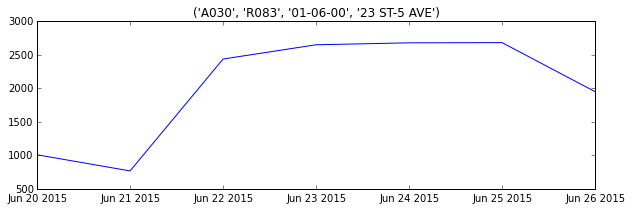

In [181]:
#The answer to challenge 4 is: 
days_list4 = []
entries_list4 = []
count = 0
for station, rows in station_entries_perday.items():
    while count < 1:
        for row in rows:
            day = row[0]
            entries = row[1]
            days_list4.append(day)
            entries_list4.append(entries)
            count += 1
        plt.figure(figsize=(10,3))
        plt.title(station)
        plt.plot(days_list4,entries_list4)

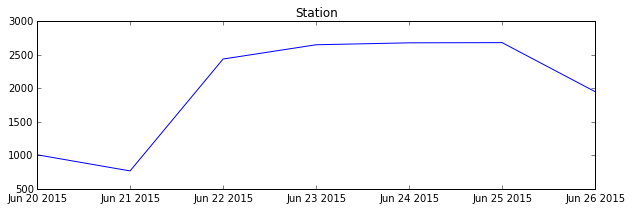

In [173]:
####answer 4
plt.figure(figsize=(10,3))
plt.title('Station')
plt.plot(days_list3,entries_list3)

In [165]:
station_days_entries = defaultdict(dict)
for turnstile, rows in station_entries_perday.items():
    station = turnstile[3]
    for date, entries in rows:
        station_days_entries[station][date] = station_days_entries[station].get(date,0) + entries
    
        
        
    
    
        

In [179]:
#the answer for challenge 5 is:
station_days_entries

defaultdict(dict,
            {'1 AVE': {datetime.date(2015, 6, 20): 18742,
              datetime.date(2015, 6, 21): 14228,
              datetime.date(2015, 6, 22): 22931,
              datetime.date(2015, 6, 23): 23768,
              datetime.date(2015, 6, 24): 24576,
              datetime.date(2015, 6, 25): 24953,
              datetime.date(2015, 6, 26): 21174},
             '103 ST': {datetime.date(2015, 6, 20): 17314,
              datetime.date(2015, 6, 21): 13841,
              datetime.date(2015, 6, 22): 25546,
              datetime.date(2015, 6, 23): 26022,
              datetime.date(2015, 6, 24): 27269,
              datetime.date(2015, 6, 25): 26679,
              datetime.date(2015, 6, 26): 24797},
             '103 ST-CORONA': {datetime.date(2015, 6, 20): 13455,
              datetime.date(2015, 6, 21): 10063,
              datetime.date(2015, 6, 22): 19684,
              datetime.date(2015, 6, 23): 19712,
              datetime.date(2015, 6, 24): 19896,
             

defaultdict(dict,
            {'1 AVE': {datetime.date(2015, 6, 20): 18742,
              datetime.date(2015, 6, 21): 14228,
              datetime.date(2015, 6, 22): 22931,
              datetime.date(2015, 6, 23): 23768,
              datetime.date(2015, 6, 24): 24576,
              datetime.date(2015, 6, 25): 24953,
              datetime.date(2015, 6, 26): 21174},
             '103 ST': {datetime.date(2015, 6, 20): 17314,
              datetime.date(2015, 6, 21): 13841,
              datetime.date(2015, 6, 22): 25546,
              datetime.date(2015, 6, 23): 26022,
              datetime.date(2015, 6, 24): 27269,
              datetime.date(2015, 6, 25): 26679,
              datetime.date(2015, 6, 26): 24797},
             '103 ST-CORONA': {datetime.date(2015, 6, 20): -8651342,
              datetime.date(2015, 6, 21): 9871,
              datetime.date(2015, 6, 22): 19684,
              datetime.date(2015, 6, 23): 18677,
              datetime.date(2015, 6, 24): 19896,
           

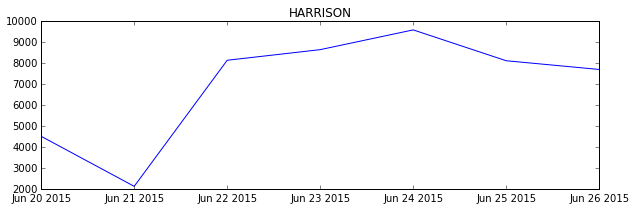

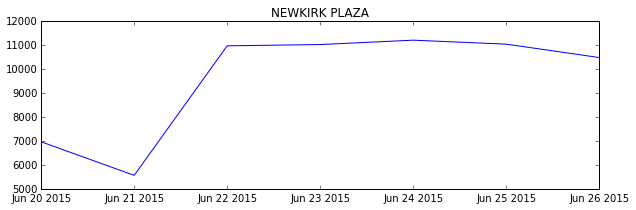

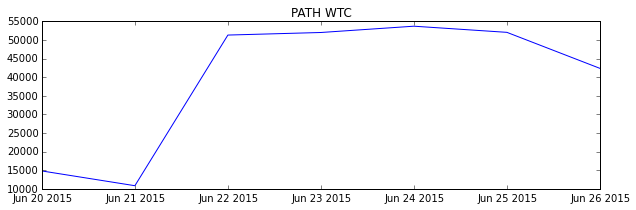

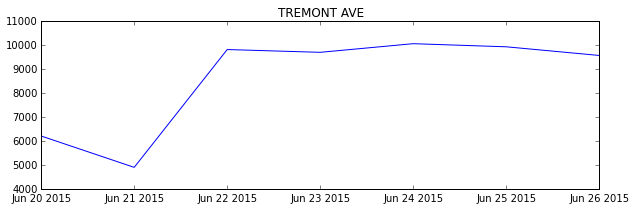

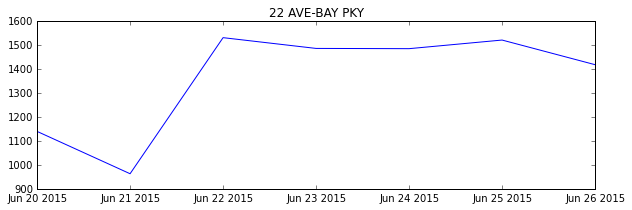

...

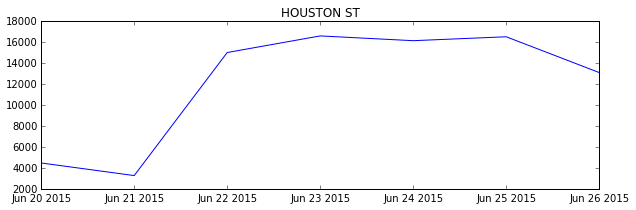

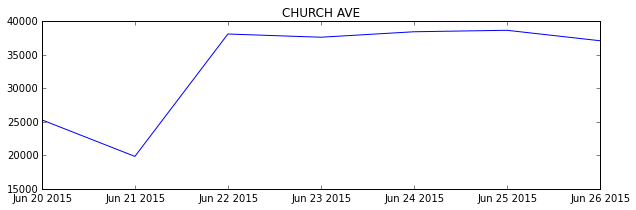

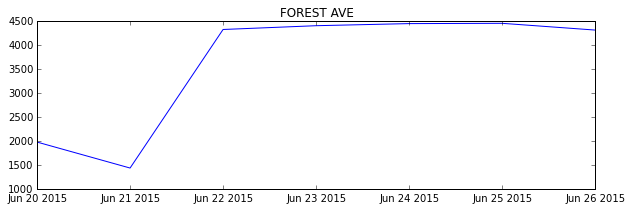

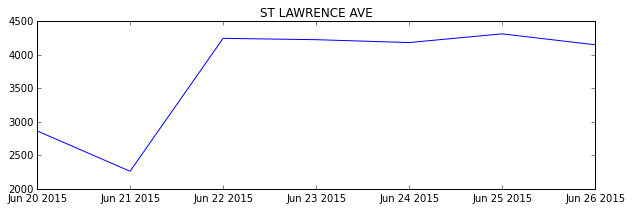

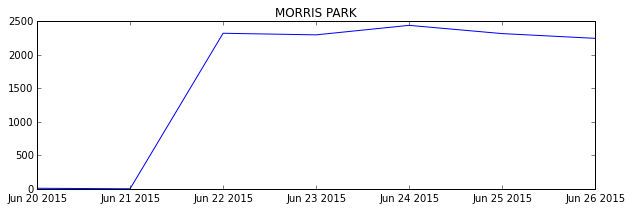

In [174]:
#The combined answers for 6 & 7:
for station, days in station_days_entries.items():
    days_list2 = []
    entries_list2 = []
    for day, entry in sorted(days.items()):
        days_list2.append(day)
        entries_list2.append(entry)
    plt.figure(figsize=(10,3))
    plt.title(station)
    plt.plot(days_list2,entries_list2)


      
        



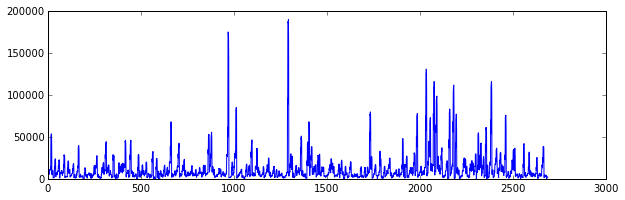

In [168]:
total_week = []
for station, days in station_days_entries.items():
    for day, entry in sorted(days.items()):
        total_week.append(entry)
plt.figure(figsize=(10,3))
plt.plot(total_week)

In [169]:
station_total = {}
for station, days in station_days_entries.items():
    for day, entries in days.items():
        station_total[station] = station_total.get(station, 0) + entries

    
    

In [170]:
#answer to challenge 9 is :
station_total

{'1 AVE': 150372,
 '103 ST': 161468,
 '103 ST-CORONA': 122220,
 '104 ST': 14130,
 '110 ST': 89757,
 '110 ST-CATHEDRL': 83346,
 '110 ST-CPN': 63142,
 '111 ST': 84708,
 '116 ST': 213188,
 '116 ST-COLUMBIA': 86000,
 '121 ST': 15399,
 '125 ST': 484018,
 '135 ST': 127894,
 '137 ST-CITY COL': 85403,
 '138 ST-3 AVE': 48208,
 '138 ST-GR CONC': 21280,
 '14 ST': 264096,
 '14 ST-6 AVE': 109569,
 '14 ST-UNION SQ': 684973,
 '145 ST': 235061,
 '148 ST-LENOX': 24608,
 '149 ST-3 AVE': 131569,
 '149 ST-GR CONC': 75368,
 '14TH STREET': 56485,
 '15 ST-PROSPECT': 40804,
 '155 ST': 42455,
 '157 ST': 70545,
 '161 ST-YANKEE': 198271,
 '163 ST-AMSTERDM': 27477,
 '167 ST': 124338,
 '168 ST-BROADWAY': 153903,
 '169 ST': 52835,
 '170 ST': 101465,
 '174 ST': 37386,
 '174-175 ST': 33158,
 '175 ST': 86478,
 '176 ST': 38575,
 '18 AVE': 100154,
 '18 ST': 51801,
 '181 ST': 144654,
 '182-183 ST': 31743,
 '183 ST': 39548,
 '190 ST': 30043,
 '191 ST': 51948,
 '2 AVE': 110996,
 '20 AVE': 54414,
 '207 ST': 41262,
 '21 ST':

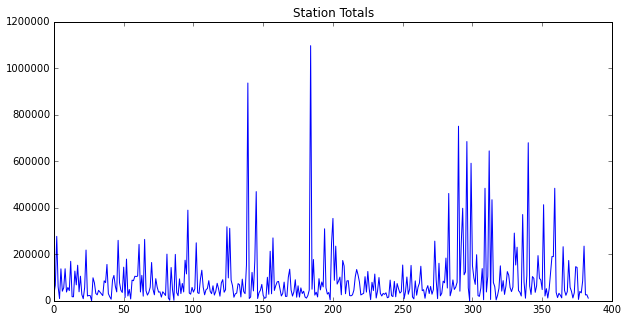

In [178]:
####The Answer to challenge 10 is the output graph:
totals_list = []
for station, entries in station_total.items():
    totals_list.append(entries)

plt.figure(figsize=(10,5))
plt.title('Station Totals')
plt.plot(totals_list) 

    